# bbCARMEN Processing Pipeline

This pipeline will classify beads and generate plots from the output files produced by a CellProfiler run.

Version 2.0

# Setup

In this section we import any required third-party packages and specify configuration options.

In [1]:
import carmenscripts
import numpy as np
# jupyter nbextension enable --py --sys-prefix widgetsnbextension

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [3]:
### Input settings ###
# Provide paths to the objects and images CSV files.
object_csv = "MyExpt_AcceptedBeads.csv"
donut_csv = "MyExpt_BeadDonuts.csv"
droplet_csv = "MyExpt_AcceptedDroplets.csv"
meta_csv = "MyExpt_Image.csv"

# A csv containing 2 columns. Column 1 ("class") is the bead class code (e.g. NNH),
# column 2 ("classname") is the name you want to assign it. Ensure there is nothing else in the file.
# Missing classes will retain their class code label
classfile = "classes.csv"

# A csv containing 2 columns. Column 1 ("sample") is the sample name the script creates (e.g. Chip1-1_210215_00_01)
# column 2 ("label") is the name you want to label the sample with in heatmaps.
# Missing samples will retain their automatically generated label
samplesfile = "samples.csv"

# A csv containing 5 columns: 
# Chip (aka plate). Lane (aka well), Condition (label used in error map), Date (as text), and Bead_class (Pooled Beads or a single class)
# Used in metric calculation and error map generation
#samplekey = "sample_key.csv"

### Output settings ###
# Where to save the resulting annotated CSV table
outputfile = "AcceptedBeads_Classified_Annotated.csv"

# Where to save the condensed CSV table
outputfile_condensed = "AcceptedBeads_Classified_Annotated_Simple.csv"

# Where to save the trackbeads CSV table
trackbeadsfile = "AcceptedBeads_Classified_Annotated_tracking.csv"

# Where to save summary table
summary_filename = "Summary_Stats.csv"

# Where to save summary table grouped per class
summary_perclass_filename = "Summary_Stats_PerClass.csv"

# Where to save heatmap source data tables
heatmap_filename = "Summary_Stats_Heatmap.csv"

# Directory name for summary plots
plotsdir = "plots"

# Directory name for class preview overlays
previewsdir = "previews"


### Element settings ###
# Create detection preview images with classes annotated?
want_overlays = False
# Choose which image to use for the class annotation background. Options are 'rgb', 'beads', 'donuts' or 'droplets'.
# Note that for non-rgb options export of the relevant image must have been enabled during the CellProfiler pipeline. 
overlay_type = 'beads'

# Which statistic should be used for averaging? Typically "Median" or "Mean". Case-sensitive.
statistic = "Median"

# Display counts on heatmaps?
want_heatmap_counts = True

# Minimum beads needed to draw colour on a heatmap
min_beads = 3

### Thresholding settings ###
# Bead class names representing control beads
control_classes = ["Scrambled 1","Scrambled 2"]
# Multiplier for IQR when determining outliers
mult_outlier = 1.5
# Multiplier for stdev when determining final thresholds 
mult_dev = 3            # 3 is default value
# Minimum fold over the control class median donut intensity for determining thresholds. 
# E.g., 2 = threshold must be at least 2x median donut blue intensity for the control bead classes
fold_minimum = 0
# Show thresholding positivity on heatmap
display_hmp_th = True

In [4]:
### Classifier settings ###
# Location of txt file containing classifier rules
# Rules files are typically named with the order of the classes within.
# the latest version of this notebook does not use the rules file
# rulesfile = "rules_20210625_VALID_INVALID.txt"

# List of classifier class names. Must be in the same order as in CP-Analyst.
# If you want to customise class names, you could do it here.
classes = ["HVN", "NHL", "NHN", "NHV", "NULL", "HNN", "MMN", "MLV", "HNV", "MNL", "NML", "NNH", "HVV"]

# Provide the name of the class for rejected beads
null_class_name = "NULL"


# Column name to use for bead class, should usually leave this untouched.
bead_class_col = "Bead_Class_Cluster"


In [5]:
# Sort and relabel the classes according to the input sheet.
classes, class_remap, label_remap, class_color_dict = carmenscripts.get_remappings(classes,
                                                                                   classfile,
                                                                                   samplesfile,
                                                                                   null_class_name,
                                                                                   palette="default")


Imported 12 class labels
Adjusted class labels are ['HRSV', 'HPIV3', 'Scrambled 1', 'FluA', 'NULL', 'SARS-CoV-2', 'FluB', 'Scrambled 2', 'HCoV_HKU1', 'BetaCoV', 'HCoV_NL63', 'RNaseP', 'HMPV']
Loaded 273 sample labels


# Read in data

Now that options are configured, it's time to import the data tables and annotate the bead data table with some metadata fields which were collected for each image. We also generate some more readable sample names.

In [6]:
# Loads and combines provided data tables.
main_df, image_df = carmenscripts.load_and_merge_data(meta_csv, object_csv, donut_csv, droplet_csv)

  0%|          | 0/6 [00:00<?, ?it/s]

# Bead classification

Our next task is to classify the beads into their different color groups. To do this, we'll import a rules.txt file generated by CellProfiler Analyst, then extract the conditions and weights. We can then apply those conditions to each bead to calculate scores for each class. Beads are assigned to the class with the highest score for that bead.

In [7]:
# Load the classifier rules. We no longer use the rules file in this latest version of the notebook
#ruleslist = carmenscripts.load_rules_file(rulesfile)

# Scores objects using the rules.
#main_df = carmenscripts.apply_rules(ruleslist, main_df, ["VALID", null_class_name])
#bypass rules
main_df["Bead_Class"] = "VALID"

# Default centroids are not meant to be strictly accurate, 
# these are seed points used for sequentially grabbing the nearest cluster to name it.
# We start from the corners and work inwards.
# Disable individual lines of this dictionary to remove that class from the detector.
default_centroids = {
    (0, 0, 1): class_remap['NNH'],
    (1, 0, 0): class_remap['HNN'],
    (0, 1, 0): class_remap['NHN'],
    (0, 0.2, 0.8): class_remap['NML'],
    (0.2, 0, 0.8): class_remap['MNL'],
    (0.2, 0.8, 0): class_remap['MMN'],
    (0.8, 0.2, 0): class_remap['HVN'],
    (0.8, 0, 0.2): class_remap['HNV'],
    (0.6, 0.2, 0.2): class_remap['HVV'],
    (0, 0.8, 0.2): class_remap['NHV'],
    (0.3, 0.55, 0.15): class_remap['MLV'],
    (0, 0.7, 0.3): class_remap['NHL'],
}

# Generates a Kmeans classifier and assigns labels to clusters.
main_df, kmeans, centroids_table = carmenscripts.classify_kmeans(main_df,
                                                                 classes,
                                                                 class_remap,
                                                                 default_centroids,
                                                                 null_class_name=null_class_name)


Clustering completed, found 13 clusters


# Adjust bead classes
This section allows the user to adjust cluster centroids. 

In [8]:
# Creates a widget to adjust cluster positions. If any are adjusted distance will be used to assign new class labels.
adjusted_centroids = centroids_table.copy()
carmenscripts.adjust_clusters(main_df, adjusted_centroids, class_color_dict, null_class_name=null_class_name, limit=5000)

/Users/rsenft/opt/anaconda3/envs/jupyter/lib/python3.8/site-packages/jupyter_client/session.py:716: UserWarning: Message serialization failed with:
Out of range float values are not JSON compliant
Supporting this message is deprecated in jupyter-client 7, please make sure your message is JSON-compliant
  content = self.pack(content)


    'data': [{'a': array([0.15994165, 0.6178362 , 0.14071101, ..., 0.32127725, 0…

In [9]:
# Run this once you're done modifying clusters.
if not adjusted_centroids.equals(centroids_table):
    main_df = carmenscripts.apply_cluster_adjustments(main_df, adjusted_centroids, null_class_name)
    final_centroids = adjusted_centroids
else:
    print("No cluster adjustments detected, will use KMeans results.")
    final_centroids = centroids_table

#generate thresholds for each sample
th_dict = carmenscripts.calculate_thresholds(main_df, control_classes, mult_outlier, mult_dev, fold_minimum=fold_minimum)

Using modified centroids. Assignment was performed based on distance.
Calculated thresholds for 273 of 273 samples


In [10]:
#OPTIONAL: This block will generate a silhouette score
## warning: this is rather slow (adding the per-object silhouette score takes a while, ~2 minutes)
main_df = carmenscripts.add_silhouette_score(main_df)                                                                 
carmenscripts.plot_silhouette_score(main_df, bead_class_col, class_color_dict, plotsdir, plot_boxplot=True, plot_visualizer=False, show=True, save=True)

K-means silhouette score: 0.6550441253238124 
Reminder: Silhouette score range is -1 to 1 where 1 is better separated clusters.


In [11]:
# Export class-annotated dataframe to CSV
if outputfile is not None:
    main_df.to_csv(outputfile, index=False)
    print(f"Finished writing {outputfile}")

# Export a simplified, easy to read dataframe.
if outputfile_condensed is not None:
    carmenscripts.save_condensed_dataframe(main_df, outputfile_condensed, extra_cols=None)

Finished writing AcceptedBeads_Classified_Annotated.csv
Wrote AcceptedBeads_Classified_Annotated_Simple.csv


# Class Overlay Images

This section will generate colour previews of the detected beads, labelled with the class assigned to them by the classifier. Preview images are saved with Red, Green and Blue channels which correspond to the Red, Green and Yellow stains.

In [12]:
# Generate overlay images with bead class names annotated.
# fmt parameter specifies output image format. 
# Exporting 'tif' is MUCH faster at the cost of more drive space than 'png'.
if want_overlays:
    carmenscripts.generate_overlays(main_df, image_df, previewsdir, kind=overlay_type, fmt="tif")

# Plots

Here we generate ternary plots displaying the normalised colour profiles of each bead. We have a few variants for each plot grouping by metadata group, class and other measures.

We also generate some intensity plots.

In [13]:
# Generate ternary for all classes, showing cluster assignments
carmenscripts.generate_ternary(
    main_df,
    class_color_dict,
    f"{plotsdir}/allbeads_clusters.png",
    centroids_table=final_centroids,
    save=True,
    show=True,
    null_class_name=null_class_name
)

# Generate ternary for all classes, without cluster display
carmenscripts.generate_ternary(
    main_df,
    class_color_dict,
    f"{plotsdir}/allbeads_classes.png",
    null_class_name=null_class_name,
    save=True,
    show=False,
)

In [14]:
# Generate per-lane ternary plots
carmenscripts.subset_ternary(
    main_df,
    "Chip_Date_Time_Lane",
    class_color_dict,
    plotsdir,
    null_class_name=null_class_name
)

  0%|          | 0/273 [00:00<?, ?it/s]

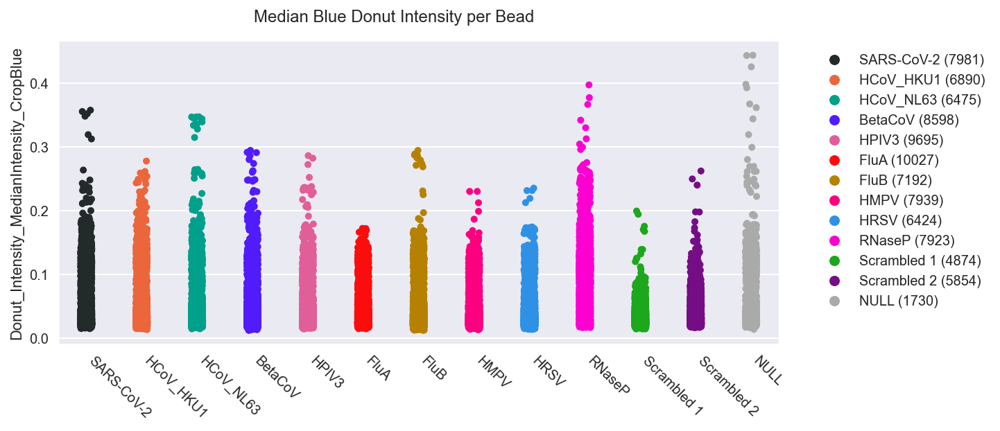

In [15]:
# Plot intensity for the whole experiment.
carmenscripts.plot_intensity_all(main_df, plotsdir, classes, "Blue", class_color_dict,
                                 stat=statistic, save=True, show=True)

In [16]:
# Plot intensity for each class. Slow step
carmenscripts.plot_intensity_persample(main_df, plotsdir, classes, "Chip_Date_Time_Lane",
                                       stat=statistic, class_color_dict=class_color_dict,
                                       threshold_dict=th_dict, save=True)

  0%|          | 0/273 [00:00<?, ?it/s]

In [17]:
# Export intensity csvs for Prism for each sample.
carmenscripts.generate_intensity_csvs_persample(main_df, plotsdir, classes, "Chip_Date_Time_Lane",
                                                stat=statistic, save=True)


  0%|          | 0/273 [00:00<?, ?it/s]

/Users/rsenft/Documents/GitHub/RebeccaSenft_Projects/003_Sabeti_Blainey_carmen/CCF182/output-exportTrackingInfo/carmenscripts.py:1025: FutureWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.



In [18]:
#OPTIONAL: This plot will generate a threshold-normalized stripplot per chip and timepoint. Note boxplots (Summarize=True) are faster.
#first we get the data organized to plot: 
collapsed_beadtable = carmenscripts.readyDataForStripPlot(main_df,th_dict, classes)

#here are lists of all chips and timepoints from the experiment:
chip_list=np.unique(main_df["Chip"])
lane_list=np.unique(main_df["Lane"])
timepoint_list=[tp for tp in np.unique(main_df["Timepoint"])] #timepoints need to be strings not ints

#Now let's save a graph for each chip. 
for chip in chip_list:
    carmenscripts.plot_norm_stripplot_wrapper(collapsed_beadtable, plotsdir, [chip], timepoint_list, 
        swapTimeandChip=False, showStat=True, stat="mean", 
        summarize=False, palette="pastel", show=False)

In [19]:
# OPTIONAL: Plot median threshold-normalized donut intensity over time using object tracking

## Note we filter data frame to remove beads that we did not track for at least 5 frames aka remove TrackObject_label == nan
# Also note that the plot_donuts_over_time function will expect to be handed a single plate of data. Subset prior if you have multiple plates
tracked_beads = carmenscripts.readyDataTrackedBeadsPlot(main_df, th_dict, classes)
tracked_beads.to_csv(trackbeadsfile, index=False)
carmenscripts.plot_donuts_over_time(tracked_beads,  
                                    bead_class_col, 
                                    class_color_dict, 
                                    timepoint_list, 
                                    plotsdir, 
                                    show=True, 
                                    save=True, 
                                    col_wrap=8, 
                                    width=1000, 
                                    height=800)

14925 images of beads removed by because they were not tracked across enough frames, representing 16.6% of bead images


# Generate summary statistics

This section will attempt to generate a summary table for each bead identity per sample. We'll need this to generate heatmaps later, but the table is also useful for a quick look at the data.

In [20]:
summary_df = carmenscripts.generate_stats(
    main_df,
    classes,
    "Chip_Date_Time_Lane",
    threshold=th_dict,
    stat=statistic,
    summaryfile=summary_filename,
    extra_cols=None
)

Wrote Summary_Stats.csv


In [21]:
class_summary_df = carmenscripts.split_summary_data(
    main_df,
    classes,
    "Chip_Date_Time_Lane",
    repr_method="median",
    outfile=summary_perclass_filename
)

Wrote Summary_Stats_PerClass.csv


In [22]:
heatmap_df, heatmap_counts = carmenscripts.generate_heatmap_table(
    class_summary_df,
    classes,
    "Chip_Date_Time_Lane",
    min_beads=min_beads,
    kind=statistic,
    outfile=heatmap_filename
)

chips, timepoints, custom_cmap = carmenscripts.fetch_misc(main_df)

Wrote Summary_Stats_Heatmap.csv


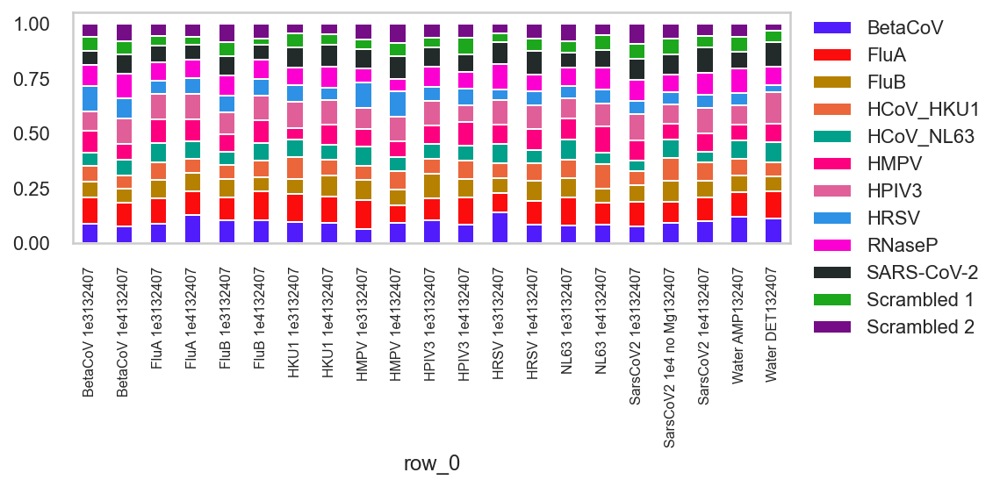

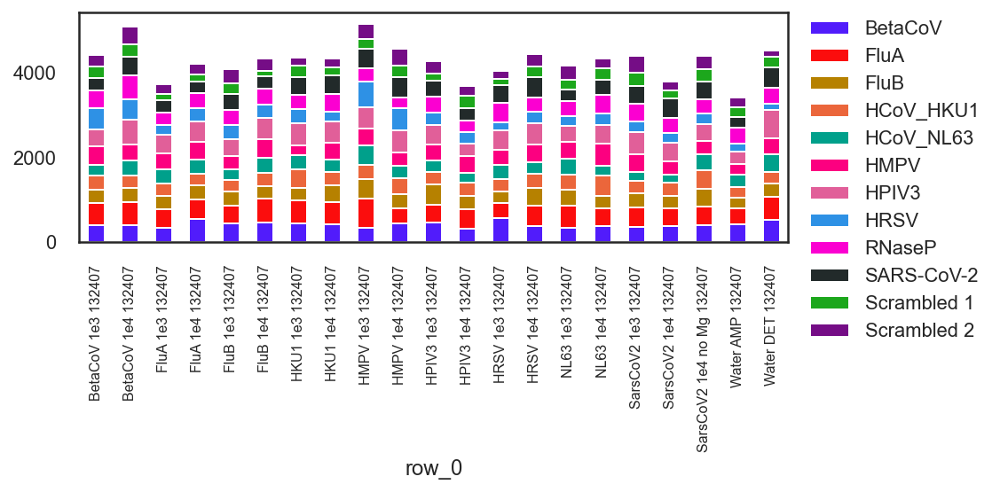

In [23]:
#Plot stacked bar plots and heat map of bead classes per well
# Useful for determining whether bead classes are roughly equal and 
# useful if you have control wells to see classification accuracy
beadtable = carmenscripts.annotate_classified_beads(outputfile_condensed, samplesfile)

carmenscripts.plot_stacked_bar(beadtable, plotsdir, color_dict=class_color_dict)
carmenscripts.plot_stacked_bar(beadtable, plotsdir, color_dict=class_color_dict, normalize=False)

carmenscripts.plot_errormap(beadtable, plotsdir, show=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


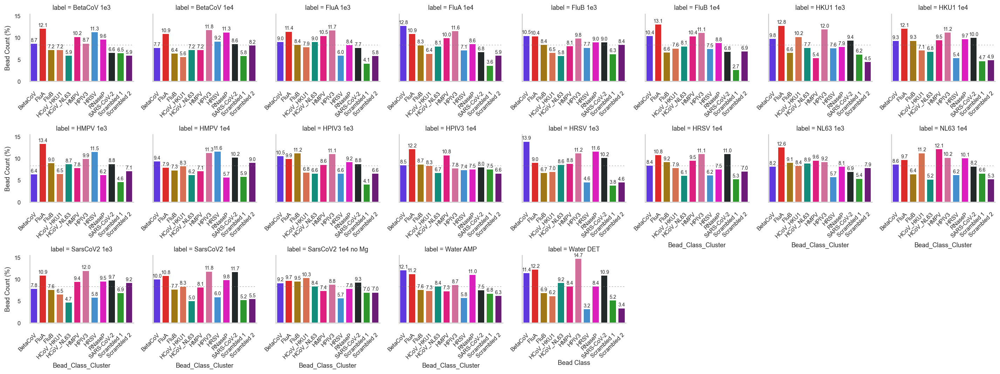

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


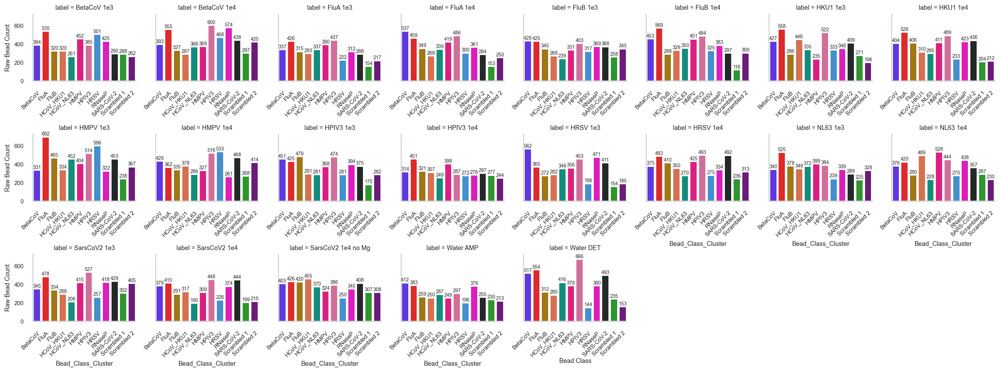

In [24]:
# unstacked bar data of bead count by well
 
#Normalized per well (% of each bead class)
carmenscripts.plot_bar(beadtable, plotsdir, palette=class_color_dict, col_wrap=8,  save=True, show=True, normalize=True, height=2.5, font_scale=.75)

#Raw bead counts per well
carmenscripts.plot_bar(beadtable, plotsdir, palette=class_color_dict, col_wrap=8, save=True, show=True, normalize=False, height=2.5, font_scale=.75)


# Make Heatmap

Let's make some fancy heatmaps!

In [25]:
# Create a heatmap of the entire experiment
full_heatmap = carmenscripts.create_heatmap(
    heatmap_df,
    heatmap_counts,
    cmap=custom_cmap,
    stat=statistic,
    label_remap=label_remap,
    min_beads=min_beads,
    display_counts=want_heatmap_counts,
    title="full",
    outdir=plotsdir,
    thresholds=th_dict if display_hmp_th else None,
)

In [26]:
# Generate heatmaps split by chip
carmenscripts.generate_split_heatmaps(
    heatmap_df,
    heatmap_counts,
    chips,
    timepoints=None,
    cmap=custom_cmap,
    stat=statistic,
    label_remap=label_remap,
    min_beads=min_beads,
    display_counts=want_heatmap_counts,
    plotsdir=plotsdir,
    thresholds=th_dict if display_hmp_th else None,
)


  0%|          | 0/1 [00:00<?, ?it/s]

In [27]:
# Generate heatmaps split by chip and timepoint
carmenscripts.generate_split_heatmaps(
    heatmap_df,
    heatmap_counts,
    chips,
    timepoints=timepoints,
    cmap=custom_cmap,
    stat=statistic,
    label_remap=label_remap,
    min_beads=min_beads,
    display_counts=want_heatmap_counts,
    plotsdir=plotsdir,
    thresholds=th_dict if display_hmp_th else None,
)

  0%|          | 0/13 [00:00<?, ?it/s]

## You're done!

In [ ]:
# Development tool - reload after modification of carmenscripts.py
from importlib import reload
reload(carmenscripts)
print("Reloaded external scripts")
%matplotlib inline
%config InlineBackend.figure_format = 'retina'